In [276]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import umap
import datetime

from tqdm import tqdm

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split, GridSearchCV
from sklearn.base import clone
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.metrics import r2_score
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn import metrics

import statsmodels.api as sm

from scipy import stats
from scipy.stats import mannwhitneyu

import gc

gc.collect()
pd.set_option('display.max_colwidth', None)
pd.set_option("display.max_columns", None)

In [281]:
cat_features = ['Marital status', 'Application mode', 'Course',
                'Previous qualification', 'Nacionality', "Mother's qualification", 
                "Father's qualification", "Mother's occupation",
                "Father's occupation"]

train_df = pd.read_csv("data/train.csv", index_col=0)
test_df = pd.read_csv("data/test.csv", index_col=0)
original_df = pd.read_csv("data/original.csv",sep=";")
train_features = test_df.columns

In [259]:
for feat in cat_features:
    dtype = pd.CategoricalDtype(categories=list(set(train_df[feat]) | set(test_df[feat]) | set(original_df[feat])), ordered=False)
    for df in [train_df, test_df, original_df]:
        df[feat] = df[feat].astype(dtype)

In [260]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 76518 entries, 0 to 76517
Data columns (total 37 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   Marital status                                  76518 non-null  category
 1   Application mode                                76518 non-null  category
 2   Application order                               76518 non-null  int64   
 3   Course                                          76518 non-null  category
 4   Daytime/evening attendance                      76518 non-null  int64   
 5   Previous qualification                          76518 non-null  category
 6   Previous qualification (grade)                  76518 non-null  float64 
 7   Nacionality                                     76518 non-null  category
 8   Mother's qualification                          76518 non-null  category
 9   Father's qualification           

In [261]:
train_df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,Displaced,Educational special needs,Debtor,Tuition fees up to date,Gender,Scholarship holder,Age at enrollment,International,Curricular units 1st sem (credited),Curricular units 1st sem (enrolled),Curricular units 1st sem (evaluations),Curricular units 1st sem (approved),Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1,1,1,9238,1,1,126.0,1,1,19,5,5,122.6,0,0,0,1,0,1,18,0,0,6,6,6,14.500000,0,0,6,7,6,12.428571,0,11.1,0.6,2.02,Graduate
1,1,17,1,9238,1,1,125.0,1,19,19,9,9,119.8,1,0,0,1,0,0,18,0,0,6,8,4,11.600000,0,0,6,9,0,0.000000,0,11.1,0.6,2.02,Dropout
2,1,17,2,9254,1,1,137.0,1,3,19,2,3,144.7,0,0,0,1,1,0,18,0,0,6,0,0,0.000000,0,0,6,0,0,0.000000,0,16.2,0.3,-0.92,Dropout
3,1,1,3,9500,1,1,131.0,1,19,3,3,2,126.1,1,0,0,1,0,1,18,0,0,7,9,7,12.591250,0,0,8,11,7,12.820000,0,11.1,0.6,2.02,Enrolled
4,1,1,2,9500,1,1,132.0,1,19,37,4,9,120.1,1,0,0,1,0,0,18,0,0,7,12,6,12.933333,0,0,7,12,6,12.933333,0,7.6,2.6,0.32,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76513,1,17,1,9254,1,1,121.0,1,19,1,7,5,116.5,1,0,0,1,0,1,18,0,0,6,9,6,10.666667,0,0,6,8,5,10.600000,0,13.9,-0.3,0.79,Graduate
76514,1,1,6,9254,1,1,125.0,1,1,38,4,9,131.6,1,0,0,1,0,0,19,0,0,6,22,4,13.000000,0,0,6,9,6,13.875000,0,9.4,-0.8,-3.12,Graduate
76515,5,17,1,9085,1,1,138.0,1,37,37,9,10,123.3,1,0,0,1,0,0,19,0,0,5,13,4,12.500000,2,0,5,8,5,11.400000,1,9.4,-0.8,-3.12,Enrolled


In [262]:
train_df.describe()

,Application order,Daytime/evening attendance,Previous qualification (grade),Admission grade,Displaced,Educational special needs,Debtor,Tuition fees up to date,Gender,Scholarship holder,Age at enrollment,International,Curricular units 1st sem (credited),Curricular units 1st sem (enrolled),Curricular units 1st sem (evaluations),Curricular units 1st sem (approved),Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
count,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.00000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000,76518.000000
mean,1.644410,0.915314,132.378766,125.363971,0.569265,0.003738,0.071382,0.893646,0.315821,0.247393,22.278653,0.006626,0.188871,5.891516,7.352362,4.178520,9.995862,0.05796,0.137053,5.933414,7.234468,4.007201,9.626085,0.062443,11.520340,1.228218,-0.080921
std,1.229645,0.278416,10.995328,12.562328,0.495182,0.061023,0.257463,0.308292,0.464845,0.431500,6.889241,0.081130,1.175296,1.671776,3.508292,2.687995,5.264224,0.40849,0.933830,1.627182,3.503040,2.772956,5.546035,0.462107,2.653375,1.398816,2.251382
min,0.000000,0.000000,95.000000,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,125.000000,118.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,18.000000,0.000000,0.000000,5.000000,6.000000,2.000000,10.666667,0.00000,0.000000,5.000000,6.000000,1.000000,10.000000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,1.000000,133.100000,124.600000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,19.000000,0.000000,0.000000,6.000000,7.000000,5.000000,12.166667,0.00000,0.000000,6.000000,7.000000,5.000000,12.142857,0.000000,11.100000,1.400000,0.320000
75%,2.000000,1.000000,140.000000,132.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,23.000000,0.000000,0.000000,6.000000,9.000000,6.000000,13.314286,0.00000,0.000000,6.000000,9.000000,6.000000,13.244048,0.000000,12.700000,2.600000,1.790000
max,9.000000,1.000000,190.000000,190.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,70.000000,1.000000,20.000000,26.000000,45.000000,26.000000,18.875000,12.00000,19.000000,23.000000,33.000000,20.000000,18.000000,12.000000,16.200000,3.700000,3.510000


In [263]:
print(train_df["Target"].value_counts() / len(train_df))

Target
Graduate    0.474163
Dropout     0.330589
Enrolled    0.195248
Name: count, dtype: float64


In [326]:
sp_rows = 7
sp_cols = 7
sp_ids = [(r, c) for r in range(1, sp_rows+1) for c in range(1, sp_cols+1)]
fig = make_subplots(rows=sp_rows, cols=sp_cols, subplot_titles=train_df.columns)

for sp, column in zip(sp_ids, train_df.columns):
    if column not in ["id"]:
        fig.append_trace(
            go.Histogram(
                histfunc="count",
                x=train_df[column],
                name=column,
            ),
            row=sp[0],
            col=sp[1],
        )

fig.update_layout(height=1000, width=1800, title_text="Histograms of all columns")
fig.show()
#fig.write_image("var_hists.png")
gc.collect()


3471

In [265]:
tmp_df = train_df.copy()
tmp_df["Target"] = tmp_df["Target"].replace(
    {"Graduate": 0, "Dropout": 1, "Enrolled": 2}
)

var_corrs = tmp_df.drop(columns=["Target"]).corr()
target_corr = tmp_df.corrwith(
    tmp_df["Target"].astype("float"), method=stats.pointbiserialr
)
var_corrs = var_corrs.merge(
    target_corr.loc[0].rename("Target"), left_index=True, right_index=True
).T
var_corrs["Target"] = target_corr.loc[0]

mask = np.zeros_like(var_corrs, dtype=bool)
mask[np.triu_indices_from(mask)] = True

df_corr_viz = var_corrs.mask(mask)
fig = px.imshow(df_corr_viz, text_auto=True)

fig.update_layout(
    height=1000,
    width=1800,
    title_text="Heatmap of variable correlations",
    xaxis=None,
)
fig.show()

gc.collect()


1243

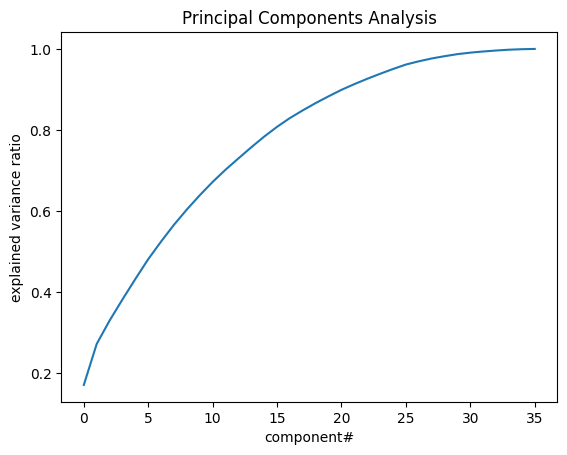

In [266]:
pca = PCA()
pca.fit(StandardScaler().fit_transform(train_df[train_features]))
plt.plot(pca.explained_variance_ratio_.cumsum())
plt.title('Principal Components Analysis')
plt.xlabel('component#')
plt.ylabel('explained variance ratio')
plt.show()

In [267]:
%%time
train_sample = train_df.sample(10000)
reducer = umap.UMAP()
embedding = reducer.fit_transform(train_sample[train_features])

fig = px.scatter(x=embedding[:, 0], y=embedding[:, 1], color=train_sample["Target"], title='Unsupervised UMAP projection of the training dataset', width=1000, height=1000)
fig.show()

d:\Programming\Languages\Python Venvs\dgl_torchgeo\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



CPU times: total: 39.4 s
Wall time: 6.48 s


In [274]:
data = [
    go.Histogram(
            x=train_df["Curricular units 1st sem (approved)"],
            name="train",
            opacity=0.5,
            histnorm="percent"
        ),
    go.Histogram(
            x=original_df["Curricular units 1st sem (approved)"],
            name="original",
            opacity=0.5,
            histnorm="percent"
        )
]

layout = go.Layout(
    barmode='overlay',
    title="Distribution of Train vs Original Dataset on <br>'Curricular units 1st sem (approved)'"
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [295]:
%%time
mann_whitney_tests = {"Original":{}, "Test":{}}
for col_name in test_df.columns:
    for df_name, df in zip(["Original", "Test"], [original_df, test_df]):
        mw_test = mannwhitneyu(train_df[col_name], df[col_name])
        mann_whitney_tests[df_name][col_name] = {"statistic":mw_test.statistic, "pvalue":mw_test.pvalue}

CPU times: total: 3.3 s
Wall time: 3.41 s


In [302]:
mw_orig = pd.DataFrame(data=mann_whitney_tests["Original"]).T
mw_test = pd.DataFrame(data=mann_whitney_tests["Test"]).T

In [325]:
data = [
    go.Bar(
        x=mw_orig.index.values,
        y=mw_orig["pvalue"],
        name="Original"
    ),
    go.Bar(
        x=mw_test.index.values,
        y=mw_test["pvalue"],
        name="Test"
    ),
]
layout = go.Layout(
    barmode='group',
    title="Mann-Whitney U Tests of all Variables between Datasets",
    yaxis_title="pvalue",
    xaxis=dict(
        showticklabels=False
    )
)
fig = go.Figure(data=data, layout=layout)
fig.add_hline(
    y=0.05,
    line=dict(
        color="green",
        width=1
    ),
    opacity=0.75
)
fig.show()